In [1]:
from PIL import Image
import pandas as pd
import numpy as np

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import argparse
# import utils
import cv2
import numpy as np
import csv

In [ ]:
image = Image.open('people_part_test.JPG')


width, height = image.size
m_per_pixel_width = width/1110
m_per_pixel_height = height/980

# for y in range(0, height, 0.56):
#     for x in range(0, width, 0.56):
#         pixel_rgb = image.getpixel((x, y))

x, y = 0, 0
while x <= width and y <= height:
    pixel_rgb = image.getpixel((x, y))
    print(pixel_rgb)
    x += m_per_pixel_width
    y += m_per_pixel_height


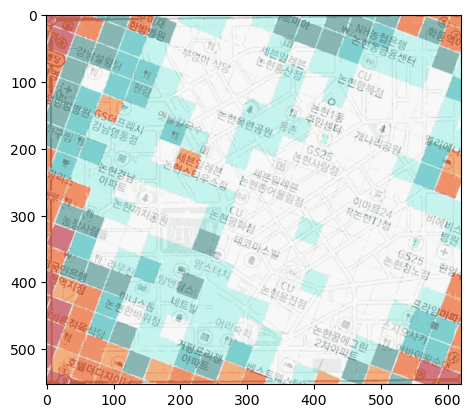

In [38]:
# 클러스터링 1
pic = plt.imread('people_part_test.JPG')/255

pic_1d = pic.reshape(pic.shape[0]*pic.shape[1], pic.shape[2])

kmean = KMeans(n_clusters=12, random_state=0, n_init=10).fit(pic_1d)
pic2show = kmean.cluster_centers_[kmean.labels_]

clusterPic = pic2show.reshape(pic.shape[0], pic.shape[1], pic.shape[2])

plt.imshow(clusterPic)

In [21]:
# 클러스터링 2 
img = cv2.imread('people_part_test.JPG')
z = img.reshape((-1, 3))

z = np.float32(z)

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
k = 12
ret, label, center = cv2.kmeans(z, k, 10000, criteria, 10, cv2.KMEANS_PP_CENTERS)

center = np.uint8(center)
res = center[label.flatten()]
res = res.reshape(img.shape)

print(center)

cv2.imshow('Original', img)
cv2.imshow('K', res)

cv2.imwrite('./test.JPG', res)

cv2.waitKey(0)
cv2.destroyAllWindows()

[[229 236 188]
 [179 181 136]
 [109 154 241]
 [248 248 247]
 [ 68  97 194]
 [207 207 127]
 [201 205 188]
 [141 146  99]
 [231 233 232]
 [159 188 236]
 [241 246 201]
 [129 120 209]]


In [76]:
# 155 155 155 ~ 248 248 248 -> 회색 -> 하안색
# +-5 

image = Image.open('people_part_test.JPG')


width, height = image.size
m_per_pixel_width = width/1110
m_per_pixel_height = height/980

for y in range(0, height):
    for x in range(0, width):
        pixel_rgb = image.getpixel((x, y))
lower_rgb = (155, 155, 155)
upper_rgb = (248, 248, 248)
threshold = 5  # +-5 범위 내에 있는 픽셀을 하안색으로 변경

new_pixel = (255, 255, 255)

# 아무것도 없는 애들을 좀 하얗게
for x in range(width):
    for y in range(height):
        pixel_rgb = image.getpixel((x, y))
        if abs(pixel_rgb[0]-pixel_rgb[1])<=5 and abs(pixel_rgb[1]-pixel_rgb[2])<=5 and abs(pixel_rgb[1]-pixel_rgb[2])<=5:
            image.putpixel((x, y), new_pixel)

output_path = "output_image.JPG"
image.save(output_path)
image.close()



In [19]:
# HSV
img = cv2.imread('people_part.JPG')

hsv_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# width, height = hsv_img.size
# m_per_pixel_width = width/1110
# m_per_pixel_height = height/980

# x, y = 0, 0
# while x <= width and y <= height:
#     pixel_rgb = image.getpixel((x, y))
#     print(pixel_rgb)
#     x += m_per_pixel_width
#     y += m_per_pixel_height


cv2.imshow('HSV image', hsv_img)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [39]:
image = Image.open('output_image.JPG')
width, height = image.size
print(height, width)

img = cv2.imread('output_image.JPG')
height, width, _ = img.shape

print(height, width)

for x in range(0, width):
    for y in range(0, height):
        pixel_color = image.getpixel((x, y))
        print(x,y,pixel_color[0],pixel_color[1],pixel_color[2])

553 621
553 621
0 0 237 27 40
0 1 240 26 38
0 2 242 25 34
0 3 242 25 34
0 4 238 27 34
0 5 231 30 36
0 6 233 29 38
0 7 237 27 40
0 8 233 29 38
0 9 255 86 79
0 10 255 149 117
0 11 255 152 101
0 12 255 126 61
0 13 255 118 42
0 14 255 123 33
0 15 254 135 33
0 16 255 126 45
0 17 255 126 43
0 18 255 126 42
0 19 255 125 40
0 20 255 126 36
0 21 255 126 35
0 22 255 128 33
0 23 253 129 31
0 24 252 130 31
0 25 250 130 33
0 26 250 130 35
0 27 250 129 36
0 28 253 128 38
0 29 255 126 40
0 30 255 124 42
0 31 255 123 42
0 32 255 126 31
0 33 255 128 34
0 34 254 129 36
0 35 248 129 35
0 36 247 130 37
0 37 249 131 41
0 38 250 130 43
0 39 252 126 41
0 40 255 127 44
0 41 255 121 38
0 42 255 120 38
0 43 255 124 39
0 44 255 128 38
0 45 255 129 35
0 46 253 129 33
0 47 251 129 30
0 48 252 133 33
0 49 250 126 40
0 50 255 128 51
0 51 253 124 43
0 52 255 125 37
0 53 255 129 39
0 54 253 123 37
0 55 255 128 41
0 56 253 128 36
0 57 252 128 38
0 58 250 128 42
0 59 252 128 40
0 60 253 129 33
0 61 255 128 29
0 62 255 1

In [4]:
# 색깔에 따라 등급 분류(색깔은 직접 지정)
global color_list
color_list = [[23, 28, 36],
              [255, 127, 39],
              [255, 242, 0],
              [34, 177, 76],
              [63, 72, 204],
              [0, 162, 232],
              [255, 255, 255]]

def checkColor(r,g,b): 
    if 227<=r<=247 and 18<=g<=38 and 26<=b<=46:
        return 1, 500
    elif 245<=r<=255 and 117<=g<=137 and 29<=b<=49:
        return 2, 375
    elif 245<=r<=255 and 232<=g<=252 and 0<=b<=10:
        return 3, 225
    elif 24<=r<=44 and 167<=g<=187 and 66<=b<=86:
        return 4, 175
    elif 53<=r<=73 and 62<=g<=82 and 194<=b<=214:
        return 5, 125
    elif 0<=r<=10 and 152<=g<=172 and 222<=b<=242:
        return 6, 75
    elif abs(r-g)<=5 and abs(g-b)<=5 and abs(r-b)<=5:
        return 7, 25
    
    else: # 없는 색상일 경우 근사색상 탐색 (차이의 최소)
        find_near = []
        for color in color_list:
            find_near.append(abs(color[0]-r)+abs(color[1]-g)+abs(color[2]-b))
        idx = find_near.index(min(find_near)) + 1
        if idx == 1:
            return 1, 500
        elif idx==2:
            return 2, 375
        elif idx==3:
            return 3, 225
        elif idx==4:
            return 4, 175
        elif idx==5:
            return 5, 125
        elif idx==6:
            return 6, 75
        elif idx==7:
            return 7, 25

#CSV파일로 추출    
def TurnCSV(img_path,columnName):
    # img = cv2.imread(img_path)
    # #이미지의 크기 확인
    # height, width, _ = img.shape

    # 위아래 똑같음

    #이미지의 크기 확인
    image = Image.open('output_image_조정.jpg')
    width, height = image.size

    #CSV파일 경로 설정
    csv_file_path = columnName + "_output.csv"

    with open(csv_file_path, mode='w', newline='',encoding='utf-8') as csv_file:
        csv_writer = csv.writer(csv_file, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)
        csv_writer.writerow(['x', 'y', columnName+'등급', columnName+'수'])

        for x in range(width):
            for y in range(height):
                # pixel_color = cv2.cvtColor(np.uint8([[img[y,x]]]))[0][0]
                pixel_color = image.getpixel((x, y))
                grade, population= checkColor(pixel_color[0],pixel_color[1],pixel_color[2])
                
                csv_writer.writerow([x,y, grade, population])  # 데이터 행 쓰기
                print(f'{x},{y},{grade},{population}')

img_path = 'output_image_조정.jpg' # 이미지 경로
columnName = "유동인구" # (분석할 데이터 이름)
TurnCSV(img_path,columnName)

0,0,1,500
0,1,1,500
0,2,1,500
0,3,1,500
0,4,1,500
0,5,1,500
0,6,1,500
0,7,1,500
0,8,1,500
0,9,1,500
0,10,1,500
0,11,1,500
0,12,2,375
0,13,2,375
0,14,2,375
0,15,2,375
0,16,2,375
0,17,2,375
0,18,2,375
0,19,2,375
0,20,2,375
0,21,2,375
0,22,2,375
0,23,2,375
0,24,2,375
0,25,2,375
0,26,2,375
0,27,2,375
0,28,2,375
0,29,2,375
0,30,2,375
0,31,2,375
0,32,2,375
0,33,2,375
0,34,2,375
0,35,2,375
0,36,2,375
0,37,2,375
0,38,2,375
0,39,2,375
0,40,2,375
0,41,2,375
0,42,2,375
0,43,2,375
0,44,2,375
0,45,2,375
0,46,2,375
0,47,2,375
0,48,2,375
0,49,2,375
0,50,2,375
0,51,2,375
0,52,2,375
0,53,2,375
0,54,2,375
0,55,2,375
0,56,2,375
0,57,2,375
0,58,2,375
0,59,2,375
0,60,2,375
0,61,2,375
0,62,2,375
0,63,2,375
0,64,2,375
0,65,2,375
0,66,2,375
0,67,2,375
0,68,2,375
0,69,2,375
0,70,2,375
0,71,2,375
0,72,2,375
0,73,2,375
0,74,2,375
0,75,2,375
0,76,2,375
0,77,2,375
0,78,2,375
0,79,2,375
0,80,2,375
0,81,2,375
0,82,2,375
0,83,2,375
0,84,2,375
0,85,2,375
0,86,2,375
0,87,2,375
0,88,2,375
0,89,2,375
0,90,2,375
0,91,2,37